# **TASK 1:** SkullStripping




## Setting up ANT's

**Binaries for performing N4BiasFieldCorrection**

In [ ]:
# install ANT's Advanced Normalization Tools

!7z x /content/drive/MyDrive/BrainsightAI/Data/ANTs_Bin/ANTs-28-03-2019.7z
!cp bin/* /usr/local/bin

# check ant
!which antsRegistration


7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,4 CPUs Intel(R) Xeon(R) CPU @ 2.20GHz (406F0),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/BrainsightAI/Data/ANTs_Bin/                                                            1 file, 315597527 bytes (301 MiB)

Extracting archive: /content/drive/MyDrive/BrainsightAI/Data/ANTs_Bin/ANTs-28-03-2019.7z
--
Path = /content/drive/MyDrive/BrainsightAI/Data/ANTs_Bin/ANTs-28-03-2019.7z
Type = 7z
Physical Size = 315597527
Headers Size = 2380
Method = LZMA2:24 BCJ
Solid = +
Blocks = 1

  0%      0% 1 - bin/ANTS                   1% 1 - bin/ANTS                   1% 2 - bin/ANTSIntegrateVectorField

## Requirements

In [ ]:
# install requirements
!pip -q install torchio
!pip -q install nipype
!pip -q install antspyx
!pip -q install pytorch-lightning
!pip install -q nilearn

## Dataset preparation

In [ ]:
# download dataset
!wget https://fcp-indi.s3.amazonaws.com/data/Projects/RocklandSample/NFBS_Dataset.tar.gz

--2022-03-23 10:20:31--  https://fcp-indi.s3.amazonaws.com/data/Projects/RocklandSample/NFBS_Dataset.tar.gz
Resolving fcp-indi.s3.amazonaws.com (fcp-indi.s3.amazonaws.com)... 54.231.203.49
Connecting to fcp-indi.s3.amazonaws.com (fcp-indi.s3.amazonaws.com)|54.231.203.49|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1751464473 (1.6G) [application/x-tar]
Saving to: ‘NFBS_Dataset.tar.gz’

NFBS_Dataset.tar.gz 100%[===================>]   1.63G  16.2MB/s    in 1m 45s  

2022-03-23 10:22:17 (15.9 MB/s) - ‘NFBS_Dataset.tar.gz’ saved [1751464473/1751464473]



In [ ]:
# copy to drive for furture
!cp NFBS_Dataset.tar.gz /content/drive/MyDrive/BrainsightAI/Data/

In [ ]:
# for second time copy back to VM
!cp /content/drive/MyDrive/BrainsightAI/Data/NFBS_Dataset.tar.gz .

In [ ]:
# extract files
!tar -xf NFBS_Dataset.tar.gz

In [ ]:
# import required
import os
from glob import glob

In [ ]:
# paths
mri_images = sorted(glob("/content/NFBS_Dataset/*/*""_T1w.nii.gz"))
mask_images = sorted(glob("/content/NFBS_Dataset/*/*""_T1w_brainmask.nii.gz"))
stripped_images = sorted(glob("/content/NFBS_Dataset/*/*""_T1w_brain.nii.gz"))

assert (len(mri_images) == len(mask_images) == len(stripped_images))

# check length
print(f"Size of dataset: {len(mri_images)}")

Size of dataset: 125


In [ ]:
# import more
import multiprocessing
import random
import enum
import time
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torchio as tio
import numpy as np
import matplotlib.pyplot as plt
import pytorch_lightning as pl


from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks.model_checkpoint import ModelCheckpoint
from tqdm.notebook import tqdm
from nipype.interfaces.ants import N4BiasFieldCorrection
from IPython import display

import nibabel as nib
from nilearn import plotting
from nilearn import image as nii

import warnings
warnings.filterwarnings("ignore")

%config InlineBackend.figure_format = 'retina'

num_workers = multiprocessing.cpu_count()
plt.rcParams['figure.figsize'] = 12, 6

# set the random seeds
np.random.seed(hash("improves reproducibility") % 2**32 - 1)
torch.manual_seed(hash("by removing stochasticity") % 2**32 - 1)
os.environ['CUDNN_DETERMINISTIC'] = '1' 
random.seed(hash("setting random seeds") % 2**32 - 1)

In [ ]:
# collect the subjects
subjects = []

for i, m, s in zip(mri_images, mask_images, stripped_images):
  subjects.append(
      tio.Subject(image = tio.ScalarImage(i),
                  mask = tio.LabelMap(m),
                  strip = tio.LabelMap(s))
  )

datasets = tio.SubjectsDataset(subjects)

# check datasets
print(f"datasets: {len(datasets)}")

datasets: 125


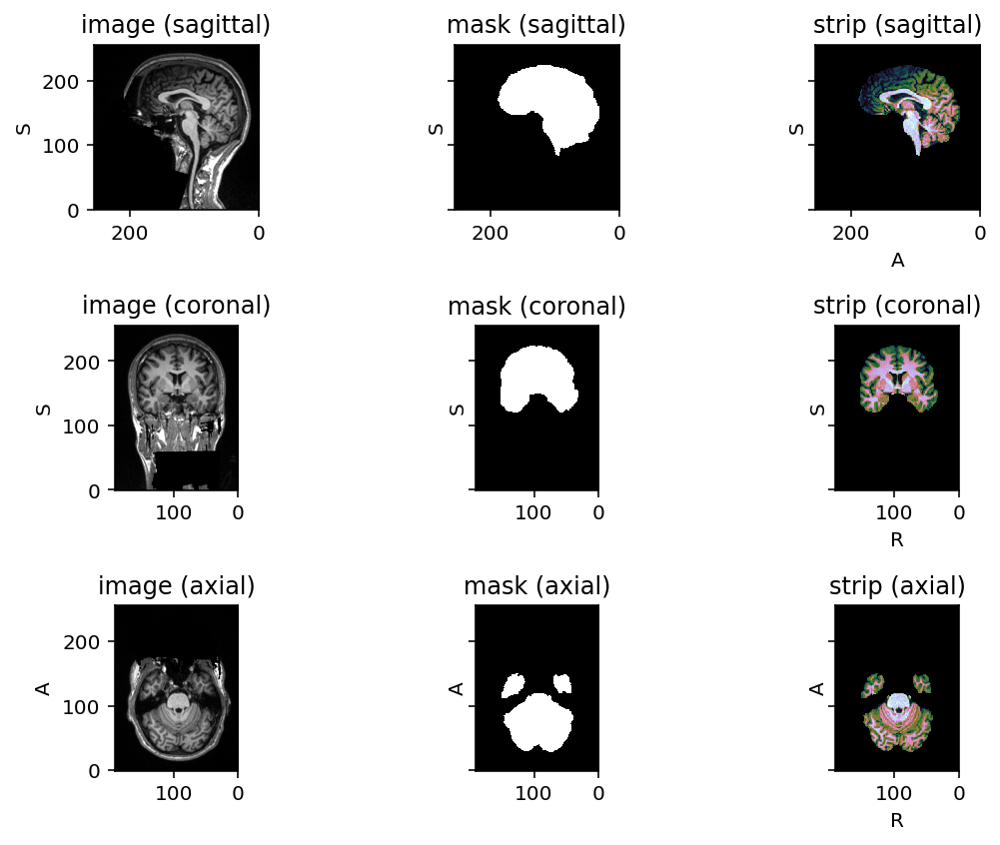

In [ ]:
# plot sample subject
random_subject = random.choice(datasets)
random_subject.plot();

### Preprocessing

#### BiasFieldCorrection

In [ ]:
# perprocessing, store (should be ran only first time)
n4 = N4BiasFieldCorrection()
n4.inputs.dimension = 3
n4.inputs.shrink_factor = 3
n4.inputs.n_iterations = [20, 10, 10, 5]

# store
# create directory
!mkdir BiasFieldCorrected
for img in tqdm(mri_images):
  subject_image = img.split("/")[-1]
  n4.inputs.input_image = img
  n4.inputs.output_image = f"/content/BiasFieldCorrected/bias_{subject_image}"
  n4.run()

  0%|          | 0/125 [00:00<?, ?it/s]

In [ ]:
# copy corrected files
!cp -R /content/BiasFieldCorrected /content/drive/MyDrive/BrainsightAI/Data/

In [ ]:
# copy saved files back to Colab VM
!cp -R /content/drive/MyDrive/BrainsightAI/Data/BiasFieldCorrected .

In [ ]:
# re read dataset with corrected files

# paths
mri_images = sorted(glob("/content/BiasFieldCorrected/*""_T1w.nii.gz"))
mask_images = sorted(glob("/content/NFBS_Dataset/*/*""_T1w_brainmask.nii.gz"))
stripped_images = sorted(glob("/content/NFBS_Dataset/*/*""_T1w_brain.nii.gz"))

assert (len(mri_images) == len(mask_images) == len(stripped_images))

# check length
print(f"Size of dataset: {len(mri_images)}")

In [ ]:
# collect the subjects
subjects = []

for i, m, s in zip(mri_images, mask_images, stripped_images):
  subjects.append(
      tio.Subject(image = tio.ScalarImage(i),
                  mask = tio.LabelMap(m),
                  strip = tio.LabelMap(s))
  )

datasets = tio.SubjectsDataset(subjects)

# check datasets
print(f"datasets: {len(datasets)}")

datasets: 125


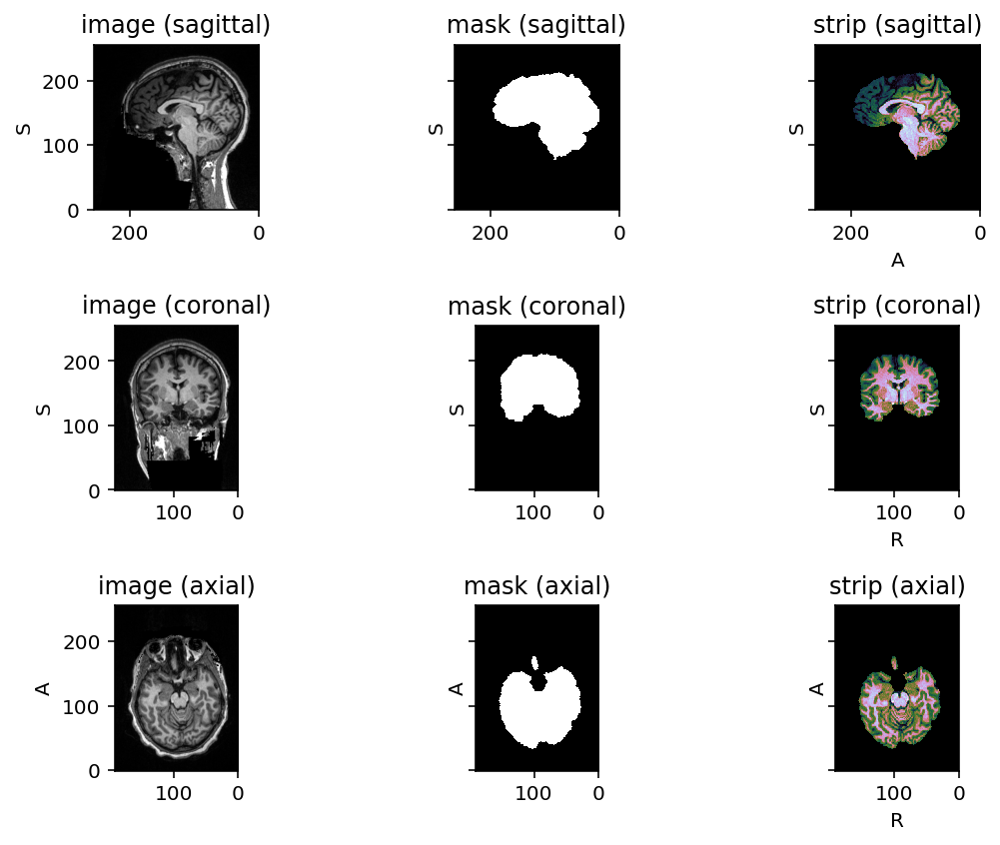

In [ ]:
# plot sample subject
random_subject = random.choice(datasets)
random_subject.plot();

In [ ]:
# re collect 
# collect the subjects
subjects = []

for i, m, _ in zip(mri_images, mask_images, stripped_images):
  subjects.append(
      tio.Subject(image = tio.ScalarImage(i),
                  mask = tio.LabelMap(m),)
  )

datasets = tio.SubjectsDataset(subjects)

# check datasets
print(f"datasets: {len(datasets)}")

datasets: 125


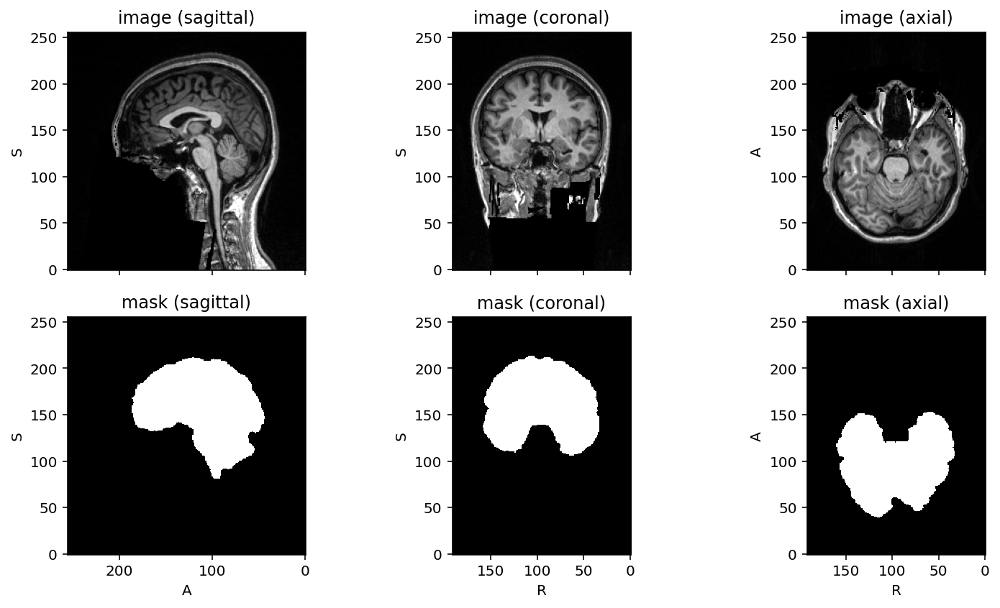

In [ ]:
# plot sample subject
random_subject = random.choice(datasets)
random_subject.plot();

#### Additional preprocessing Augementation




##### Preprocessing

* Make Canonical same for all sets
* Resize
* Intensity Normalization usign ZNormalization

##### Augmentations

* RandomAffine
* RandomBiasField
* RandomNoise

In [ ]:
# preprocessing augmentation
preprocessing = [tio.ToCanonical(),
                 tio.Resize((256, 256, 192)),
                 tio.ZNormalization(masking_method=tio.ZNormalization.mean)]

train_transfrom = tio.Compose(preprocessing + [tio.RandomFlip(),
                                               tio.OneOf(
                                                   [tio.RandomAffine(scales=(0.9, 1.2),degrees=15),
                                                    tio.RandomBiasField(),
                                                    tio.RandomNoise(0, (0,0.02))]
                                               )])


valid_transform = tio.Compose(preprocessing)

#### Training and Validation Split

In [ ]:
# train valid split

VALID_SPLIT = 0.2

num_datasets = len(datasets)
valid_split = int(VALID_SPLIT * num_datasets)
train_split = num_datasets - valid_split

train_data, valid_data = torch.utils.data.random_split(datasets, (train_split, valid_split))

train_set = tio.SubjectsDataset(train_data, train_transfrom)
valid_set = tio.SubjectsDataset(valid_data, valid_transform)

In [ ]:
# check lengths of train, valid data
print(f"Training Dataset: {len(train_set)}")

print(f"Validation Dataset: {len(valid_set)}")

Training Dataset: 100
Validation Dataset: 25


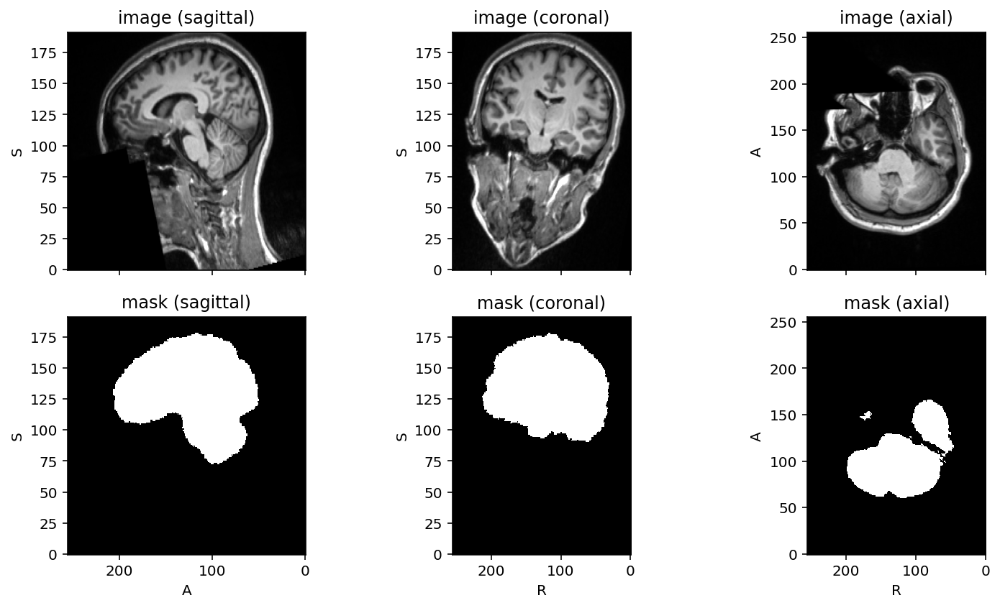

In [ ]:
# plot sample subject
random_subject = random.choice(train_set)
random_subject.plot();

### Model

In [ ]:
class ConvBlock(nn.Module):
  def __init__(self, in_channel, out_channel, kernel_size=3, stride=1, padding="same"):
    super(ConvBlock, self).__init__()
    self.conv = nn.Conv3d(in_channel, out_channel, kernel_size, stride, padding)
    self.batch_norm = nn.BatchNorm3d(out_channel)
    self.activation = nn.ReLU()

  def forward(self, x):
    return self.activation(self.batch_norm(self.conv(x)))


class Pooling(nn.Module):
  def __init__(self, kernel_size=2, stride=2, padding=0):
    super(Pooling, self).__init__()
    self.pool = nn.MaxPool3d(kernel_size=kernel_size, stride=stride, padding=padding)

  def forward(self, x):
    return self.pool(x)


class DeConvBlock(nn.Module):
  def __init__(self, in_channel, out_channel, kernel_size=3, stride=2, padding=1):
    super(DeConvBlock, self).__init__()
    self.deconv = nn.ConvTranspose3d(in_channel, out_channel, kernel_size, 
                                stride, padding=padding, output_padding=1)
    self.batch_norm = nn.BatchNorm3d(out_channel)
    self.activation = nn.ReLU()

  def forward(self, x):
    return self.activation(self.batch_norm(self.deconv(x)))


class ModifiedUNet(nn.Module):
    def __init__(self, in_channels, out_classes):
      """
      Modiefied UNetModel
      Ref: https://arxiv.org/abs/1810.10853

      Args:
        in_channels: input dimension channel
        out_classes: out put classes
      """
      
      super(ModifiedUNet, self).__init__()

      self.in_channels = in_channels
      self.out_classes = out_classes

      # input interface
      self.conv_1 = ConvBlock(in_channels, 16)
      self.conv_2 = ConvBlock(16, 16)

      # encoding module
      self.conv_3 = ConvBlock(16, 16, 3, 1, "same")
      self.conv_4 = ConvBlock(16, 16 * 2, 3, 1, "same")
      self.pool_1 = Pooling()

      self.conv_5 = ConvBlock(16 * 2, 16 * 2, 3, 1, "same")
      self.conv_6 = ConvBlock(16 * 2, 16 * 4, 3, 1, "same")
      self.pool_2 = Pooling()

      self.conv_7 = ConvBlock(16 * 4, 16 * 4, 3, 1, "same")
      self.conv_8 = ConvBlock(16 * 4, 16 * 8, 3, 1, "same")
      self.pool_3 = Pooling()

      self.conv_9 = ConvBlock(16 * 8, 16 * 8, 3, 1, "same")
      self.conv_10 = ConvBlock(16 * 8, 16 * 8, 3, 1, "same")
      self.pool_4 = Pooling()

      # compression module
      self.conv_11 = ConvBlock(16 * 8, 16 * 2, 3, 1, "same")
      self.conv_12 = ConvBlock(16 * 2, 16 * 8, 1, 1, "same")

      self.conv_13 = ConvBlock(16 * 8, 16 * 2, 3, 1, "same")
      self.conv_14 = ConvBlock(16 * 2, 16 * 8, 1, 1, "same")

      self.conv_15 = ConvBlock(16 * 8, 16 * 2, 3, 1, "same")
      self.conv_16 = ConvBlock(16 * 2, 16 * 8, 1, 1, "same")

      # decoding module
      self.deconv_1 = DeConvBlock(16 * 8, 16 * 8, 3, 2)
      self.conv_17 = ConvBlock(16 * 8, 16 * 8, 3, 1, "same")
      self.conv_18 = ConvBlock(16 * 16, 16 * 16, 3, 1, "same")
      self.conv_19 = ConvBlock(16 * 16, 16 * 4, 1, 1, "same")

      self.deconv_2 = DeConvBlock(16 * 4, 16 * 4, 3, 2)
      self.conv_20 = ConvBlock(16 * 4, 16 * 4, 3, 1, "same")
      self.conv_21 = ConvBlock(16 * 8, 16 * 8, 3, 1, "same")
      self.conv_22 = ConvBlock(16 * 8, 16 * 2, 1, 1, "same")

      self.deconv_3 = DeConvBlock(16 * 2, 16 * 2, 3, 2)
      self.conv_23 = ConvBlock(16 * 2, 16 * 2, 3, 1, "same")
      self.conv_24 = ConvBlock(16 * 4, 16 * 4, 3, 1, "same")
      self.conv_25 = ConvBlock(16 * 4, 16 * 1, 1, 1, "same")

      self.deconv_4 = DeConvBlock(16 * 1, 16 * 1, 3, 2)
      self.conv_26 = ConvBlock(16 * 1, 16 * 1, 3, 1, "same")
      self.conv_27 = ConvBlock(16 * 2, 16 * 2, 3, 1, "same")
      self.conv_28 = ConvBlock(16 * 2, 16 * 1, 1, 1, "same")

      self.conv_29 = ConvBlock(16 * 1, 16 * 1, 1, 1, "same")
      self.deconv_5 = DeConvBlock(16 * 2, 16 * 1, 3, 2)
      self.conv_30 = ConvBlock(16 * 1, 16 * 1, 1, 1, "same")

      # classification layer
      self.conv_31 = ConvBlock(16 * 1, out_classes, 3, 2, 1)

    def forward(self, x):

        # interface module
        skip_1 = self.conv_1(x)
        x = self.conv_2(skip_1)

        # encoding module
        skip_2 = self.conv_3(x)
        x = self.conv_4(skip_2)
        x = self.pool_1(x)

        skip_3 = self.conv_5(x)
        x = self.conv_6(skip_3)
        x = self.pool_2(x)

        skip_4 = self.conv_7(x)
        x = self.conv_8(skip_4)
        x = self.pool_3(x)

        skip_5 = self.conv_9(x)
        x = self.conv_10(skip_5)
        x = self.pool_4(x)

        # compression module
        x = self.conv_11(x)
        x = self.conv_12(x)
        x = self.conv_13(x)
        x = self.conv_14(x)
        x = self.conv_15(x)
        x = self.conv_16(x)

        # decoding module
        x = self.deconv_1(x)
        x = self.conv_17(x)
        cat_5 = torch.cat([skip_5, x], 1)
        x = self.conv_18(cat_5)
        x = self.conv_19(x)

        x = self.deconv_2(x)
        x = self.conv_20(x)
        cat_4 = torch.cat([skip_4, x], 1)
        x = self.conv_21(cat_4)
        x = self.conv_22(x)

        x = self.deconv_3(x)
        x = self.conv_23(x)
        cat_3 = torch.cat([skip_3, x], 1)
        x = self.conv_24(cat_3)
        x = self.conv_25(x)

        x = self.deconv_4(x)
        x = self.conv_26(x)
        cat_2 = torch.cat([skip_2, x], 1)
        x = self.conv_27(cat_2)
        x = self.conv_28(x)

        x = self.conv_29(x)
        cat_1 = torch.cat([skip_1, x], 1)
        x = self.deconv_5(cat_1)
        x = self.conv_30(x)

        y = self.conv_31(x)
        y = torch.sigmoid(y)

        return y

#### Loss

In [ ]:
CHANNELS_DIMENSION = 1
SPATIAL_DIMENSIONS = 2, 3, 4

def get_dice_score(output, target, epsilon=1e-9):
  """
  Dice score

  Args:
    output: model predicted output
    target: grouth truth
    epsilon: epsilon
  Returns:
    dice score
  """

  p0 = output
  g0 = target
  p1 = 1 - p0
  g1 = 1 - g0
  tp = (p0 * g0).sum(dim=SPATIAL_DIMENSIONS)
  fp = (p0 * g1).sum(dim=SPATIAL_DIMENSIONS)
  fn = (p1 * g0).sum(dim=SPATIAL_DIMENSIONS)
  num = 2 * tp
  denom = 2 * tp + fp + fn + epsilon
  dice_score = num / denom
  return dice_score

def get_dice_loss(output, target):
  """
  Dice Loss
  1 - Dice Score

  Args:
    output: model predicted output
    target: grouth truth
  Returns:
    dice loss
  """

  return 1 - get_dice_score(output, target)

#### Hyper Parameters

In [ ]:
training_batch_size = 12
validation_batch_size = training_batch_size//2

patch_size = 48
samples_per_volume = 8
max_queue_length = 9
sampler = tio.data.UniformSampler(patch_size)

#### Train and Valid Data Loader

In [ ]:
patches_training_set = tio.Queue(
    subjects_dataset=train_set,
    max_length=max_queue_length,
    samples_per_volume=samples_per_volume,
    sampler=sampler,
    num_workers=2,
    shuffle_subjects=True,
    shuffle_patches=True,
)

patches_validation_set = tio.Queue(
    subjects_dataset=valid_set,
    max_length=max_queue_length,
    samples_per_volume=samples_per_volume,
    sampler=sampler,
    num_workers=2,
    shuffle_subjects=False,
    shuffle_patches=False,
)

training_loader_patches = torch.utils.data.DataLoader(
    patches_training_set, batch_size=training_batch_size)

validation_loader_patches = torch.utils.data.DataLoader(
    patches_validation_set, batch_size=validation_batch_size)

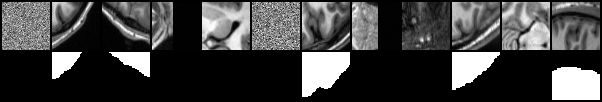

In [ ]:
# plot few
one_batch = next(iter(training_loader_patches))
k = int(patch_size // 4)
batch_image = one_batch['image'][tio.DATA][..., k]
batch_mask = one_batch['mask'][tio.DATA][..., k]
slices = torch.cat((batch_image, batch_mask))
image_path = 'batch_patches.png'
torchvision.utils.save_image(
    slices,
    image_path,
    nrow=training_batch_size,
    normalize=True,
    scale_each=True,
)
display.Image(image_path)

#### Training BoilerPlate

In [ ]:
class Action(enum.Enum):
    TRAIN = 'Training'
    VALIDATE = 'Validation'

def prepare_batch(batch, device):
    inputs = batch['image'][tio.DATA].to(device)
    targets = batch['mask'][tio.DATA].to(device)
    return inputs, targets

def get_model_and_optimizer(device):
    model = ModifiedUNet(
        in_channels=1,
        out_classes=1,
    ).to(device)
    optimizer = torch.optim.AdamW(model.parameters())
    return model, optimizer

def run_epoch(epoch_idx, action, loader, model, optimizer):
    is_training = action == Action.TRAIN
    epoch_losses = []
    times = []
    model.train(is_training)
    for batch_idx, batch in enumerate(tqdm(loader)):
        inputs, targets = prepare_batch(batch, device)
        optimizer.zero_grad()
        with torch.set_grad_enabled(is_training):
            logits = model(inputs)
            # probabilities = F.softmax(logits, dim=CHANNELS_DIMENSION)
            batch_losses = get_dice_loss(logits, targets)
            batch_loss = batch_losses.mean()
            if is_training:
                batch_loss.backward()
                optimizer.step()
            times.append(time.time())
            epoch_losses.append(batch_loss.item())
    epoch_losses = np.array(epoch_losses)
    print(f'{action.value} mean loss: {epoch_losses.mean():0.3f}')
    return times, epoch_losses

def train(num_epochs, training_loader, validation_loader, model, optimizer, weights_stem):
    train_losses = []
    val_losses = []
    val_losses.append(run_epoch(0, Action.VALIDATE, validation_loader, model, optimizer))
    for epoch_idx in range(1, num_epochs + 1):
        print('Starting epoch', epoch_idx)
        train_losses.append(run_epoch(epoch_idx, Action.TRAIN, training_loader, model, optimizer))
        val_losses.append(run_epoch(epoch_idx, Action.VALIDATE, validation_loader, model, optimizer))
        torch.save(model.state_dict(), f'{weights_stem}_epoch_{epoch_idx}.pth')
    return np.array(train_losses), np.array(val_losses)

#### Training

In [ ]:
torch.cuda.empty_cache()

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else 'cpu'
model, optimizer = get_model_and_optimizer(device)

In [ ]:
weights_stem = "/content/drive/MyDrive/BrainsightAI/Weights/SkullStripping/Epochs/"
weights_path = '/content/drive/MyDrive/BrainsightAI/Weights/SkullStripping/weights.pth'

In [ ]:
train_losses, val_losses = train(
        50,
        training_loader_patches,
        validation_loader_patches,
        model,
        optimizer,
        weights_stem)
checkpoint = {
          'train_losses': train_losses,
          'val_losses': val_losses,
          'weights': model.state_dict(),
      }
torch.save(checkpoint, weights_path)

  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.768
Starting epoch 1


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.734


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.713
Starting epoch 2


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.728


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.759
Starting epoch 3


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.736


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.715
Starting epoch 4


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.745


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.726
Starting epoch 5


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.704


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.729
Starting epoch 6


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.689


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.738
Starting epoch 7


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.709


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.675
Starting epoch 8


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.684


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.754
Starting epoch 9


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.694


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.710
Starting epoch 10


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.733


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.733
Starting epoch 11


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.682


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.702
Starting epoch 12


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.717


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.674
Starting epoch 13


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.725


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.689
Starting epoch 14


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.705


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.708
Starting epoch 15


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.708


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.666
Starting epoch 16


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.707


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.684
Starting epoch 17


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.695


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.688
Starting epoch 18


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.712


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.670
Starting epoch 19


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.674


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.713
Starting epoch 20


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.702


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.749
Starting epoch 21


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.705


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.726
Starting epoch 22


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.712


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.708
Starting epoch 23


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.683


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.748
Starting epoch 24


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.713


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.749
Starting epoch 25


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.706


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.698
Starting epoch 26


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.665


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.702
Starting epoch 27


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.686


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.713
Starting epoch 28


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.676


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.748
Starting epoch 29


  0%|          | 0/67 [00:00<?, ?it/s]

Training mean loss: 0.696


  0%|          | 0/34 [00:00<?, ?it/s]

Validation mean loss: 0.722
Starting epoch 30


  0%|          | 0/67 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

__The training processe was interrupted to stop, has the model is taking too long to train on cloab GPU__




#### Validation

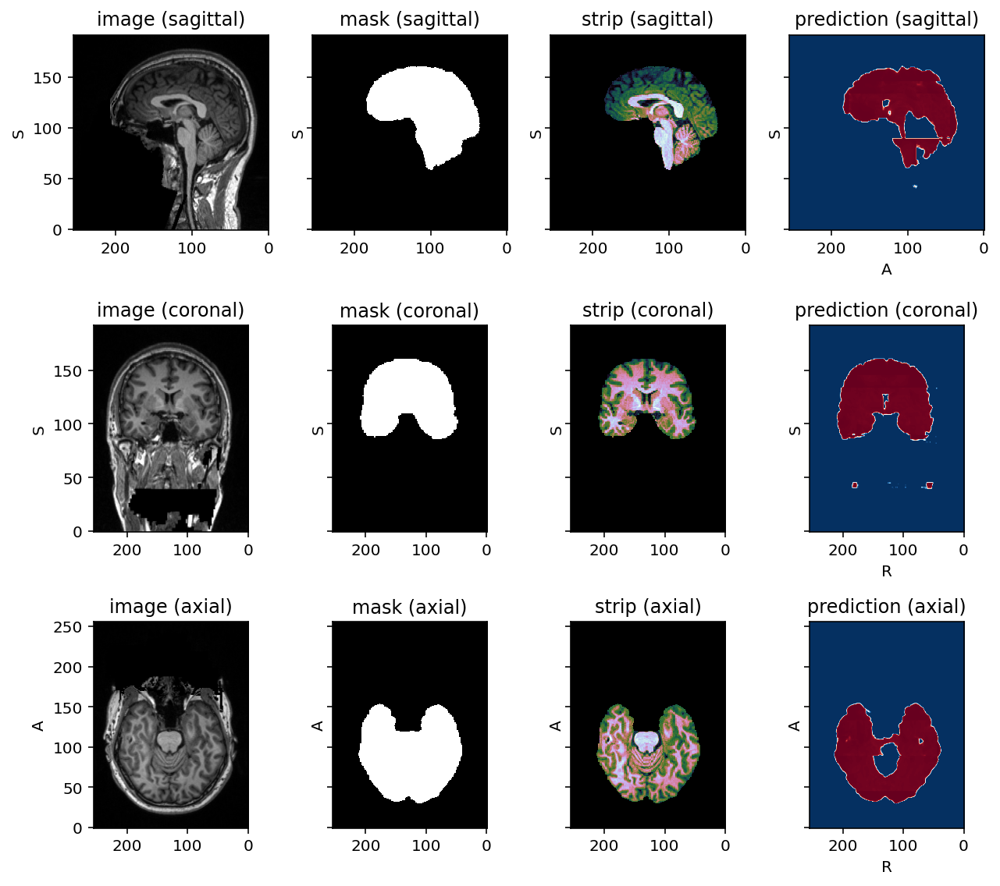

In [ ]:
subject = random.choice(valid_set)
# input_tensor = subject.image.data[0]
patch_size = 48, 48, 48  # we can user larger patches for inference
patch_overlap = 4, 4, 4
grid_sampler = tio.inference.GridSampler(
    subject,
    patch_size,
    patch_overlap,
)
patch_loader = torch.utils.data.DataLoader(
    grid_sampler, batch_size=validation_batch_size)
aggregator = tio.inference.GridAggregator(grid_sampler)

load_model.eval()
with torch.no_grad():
    for patches_batch in patch_loader:
        inputs = patches_batch['image'][tio.DATA].to(device)
        locations = patches_batch[tio.LOCATION]
        probabilities = load_model(inputs)
        aggregator.add_batch(probabilities, locations)


foreground = aggregator.get_output_tensor()
affine = subject.image.affine
prediction = tio.ScalarImage(tensor=foreground, affine=affine)
subject.add_image(prediction, 'prediction')
subject.plot(figsize=(9, 8), cmap_dict={'prediction': 'RdBu_r'})

In [ ]:
# save weights
torch.save({"weights": model.state_dict()}, 
           "/content/drive/MyDrive/BrainsightAI/Weights/SkullStripping/ModifiedUnet_weights.pt")

## Conclusion

The model loss seems to oscillate, could be due to high learning rate, model size is big.

Furture more work is needed with better computing resource

#### Future Work

* Shift to Pytorch lighting
* Decereas Model Size and train
* Hands on Vanilla UNet as baseline model and check
* make sure the there is not change in header
* validation using metrics on validation dataset

### Inference

In [ ]:
class Inference:
  def __init__(self, model, model_weights):
    """
    Inference

    Args:
      model: model object
      model_weights: model weights
    """

    self.model = model
    self.checkpoints = torch.load(model_weights)
    self.model.load_state_dict(self.checkpoints['weights'])
    self.device = torch.device('cuda') if torch.cuda.is_available() else 'cpu'
    self.model.to(self.device)
    self.validation_batch_size = 16
    self.patch_size = 48, 48, 48
    self.patch_overlap = 4, 4, 4
    self.threshold = 0.5

  def biasfieldcorrection(self, image_path, out_path):
    # biasfieldcorrection
    n4 = N4BiasFieldCorrection()
    n4.inputs.dimension = 3
    n4.inputs.shrink_factor = 3
    n4.inputs.n_iterations = [20, 10, 10, 5]
    n4.inputs.input_image = image_path
    n4.inputs.output_image = out_path
    res = n4.run()

  def __input_pipeline(self, image_path, show_plot):
    # input pipeline
    path = '/'.join(image_path.split("/")[:-1])
    out_path = path + "/bias_" + image_path.split("/")[-1]

    self.biasfieldcorrection(image_path, out_path)

    # image_path = f"{image_path}"

    subject = tio.Subject(image = tio.ScalarImage(out_path))

    # subject_affine = subject.image.affine
    # subject_shape = subject.shape[1:]

    preprocessing = tio.Compose([tio.ToCanonical(),
                                tio.Resize((256, 256, 192)),
                                tio.ZNormalization(masking_method=tio.ZNormalization.mean)])
    
    preprocessed_subject = preprocessing(subject)

    subject_affine = preprocessed_subject.image.affine

    grid_sampler = tio.inference.GridSampler(
        preprocessed_subject,
        self.patch_size,
        self.patch_overlap,
      )
    
    patch_loader = torch.utils.data.DataLoader(
    grid_sampler, batch_size=self.validation_batch_size)
    aggregator = tio.inference.GridAggregator(grid_sampler)

    self.model.eval()
    with torch.no_grad():
      for patches_batch in patch_loader:
        inputs = patches_batch['image'][tio.DATA].to(self.device)
        locations = patches_batch[tio.LOCATION]
        probabilities = self.model(inputs)
        aggregator.add_batch(probabilities, locations)
    foreground = aggregator.get_output_tensor()
    prediction = tio.ScalarImage(tensor=foreground, affine=subject_affine)

    mask = (foreground > 0.5).type(torch.int) * preprocessed_subject.image.data
    stripped = tio.ScalarImage(tensor=mask, affine=subject_affine)
    subject.add_image(prediction, 'mask')
    subject.add_image(stripped, "strip")

    if show_plot:
      subject.plot()

    final_path = path + "/stripped_" + image_path.split("/")[-1]
    
    subject.strip.save(f"{final_path}")
  
  def skullstrip(self, image, show_plot):
    """
    API for skull stripping

    Args:
      image: image path
      show_plot: if True shows tht torcio plot (only for debug on cloab here)
    """
    self.__input_pipeline(image, show_plot)

In [ ]:
# load model object
load_model = ModifiedUNet(1, 1)

In [ ]:
# unzip test data
!unzip /content/drive/MyDrive/BrainsightAI/Data/T1w_MRI_test_data.zip

In [ ]:
# fit API
API = Inference(load_model, "/content/drive/MyDrive/BrainsightAI/Weights/SkullStripping/ModifiedUnet_weights.pt")

#### call API

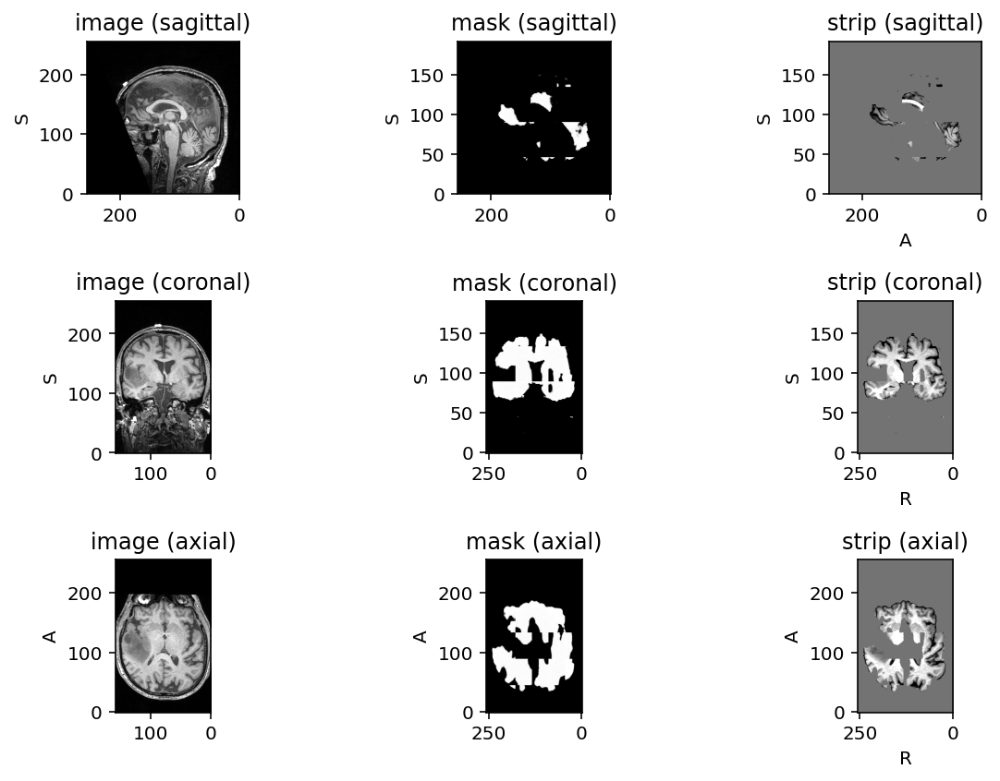

In [ ]:
# call API
API.skullstrip("/content/T1Img/sub-01/T1w.nii.gz", True)

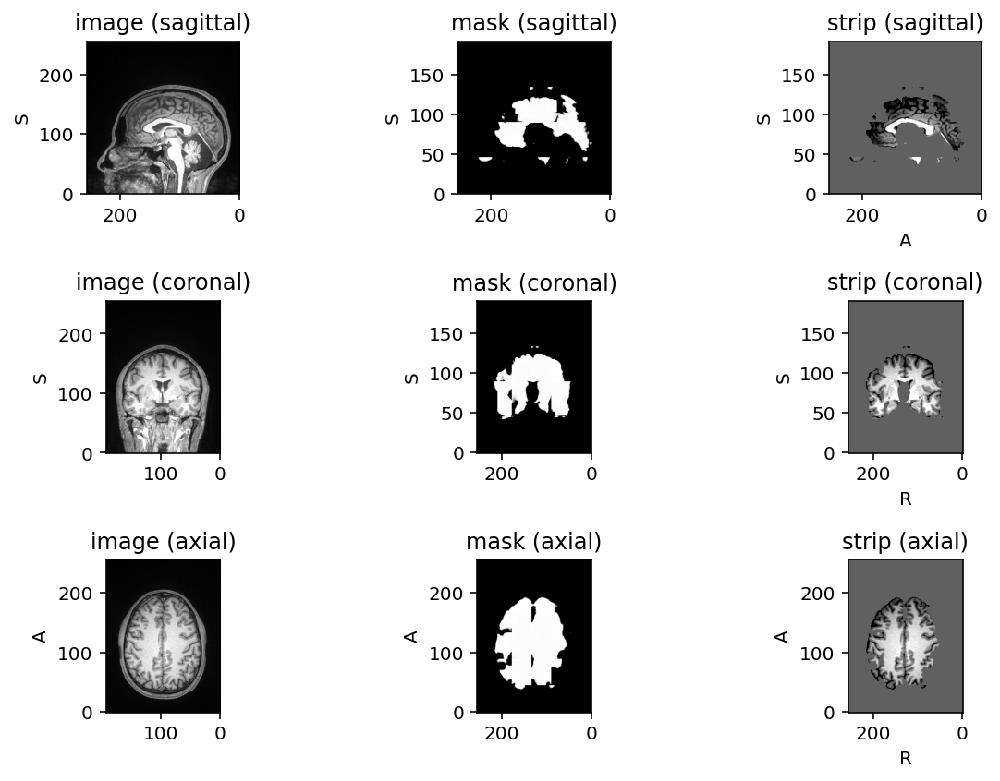

In [ ]:
API.skullstrip("/content/T1Img/sub-02/anat_img.nii.gz", True)

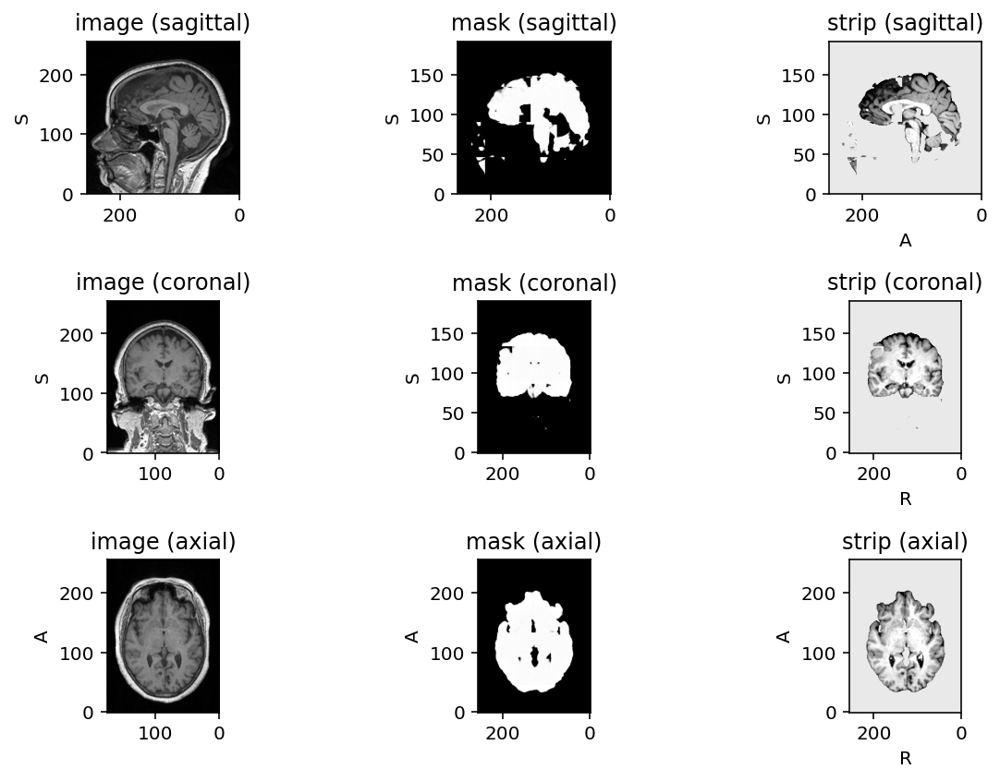

In [ ]:
API.skullstrip("/content/T1Img/sub-03/T1w_MRI.nii", True)

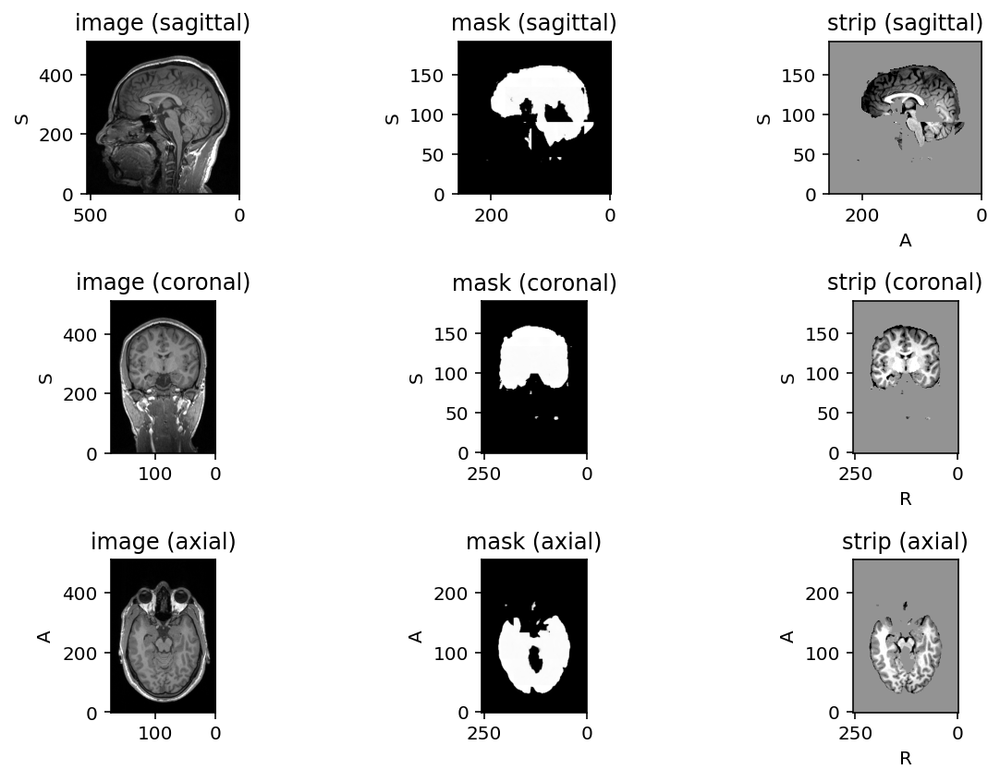

In [ ]:
API.skullstrip("/content/T1Img/sub-04/T1w_MRI.nii", True)

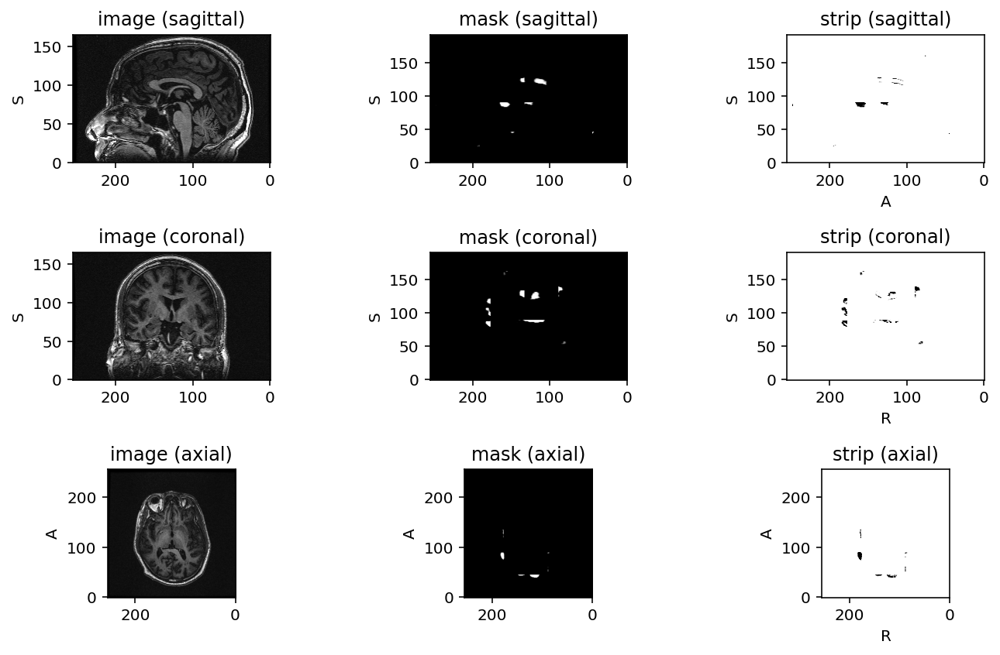

In [ ]:
API.skullstrip("/content/T1Img/sub-05/T1w_MRI.nii", True)

#### plotting saved stripped files


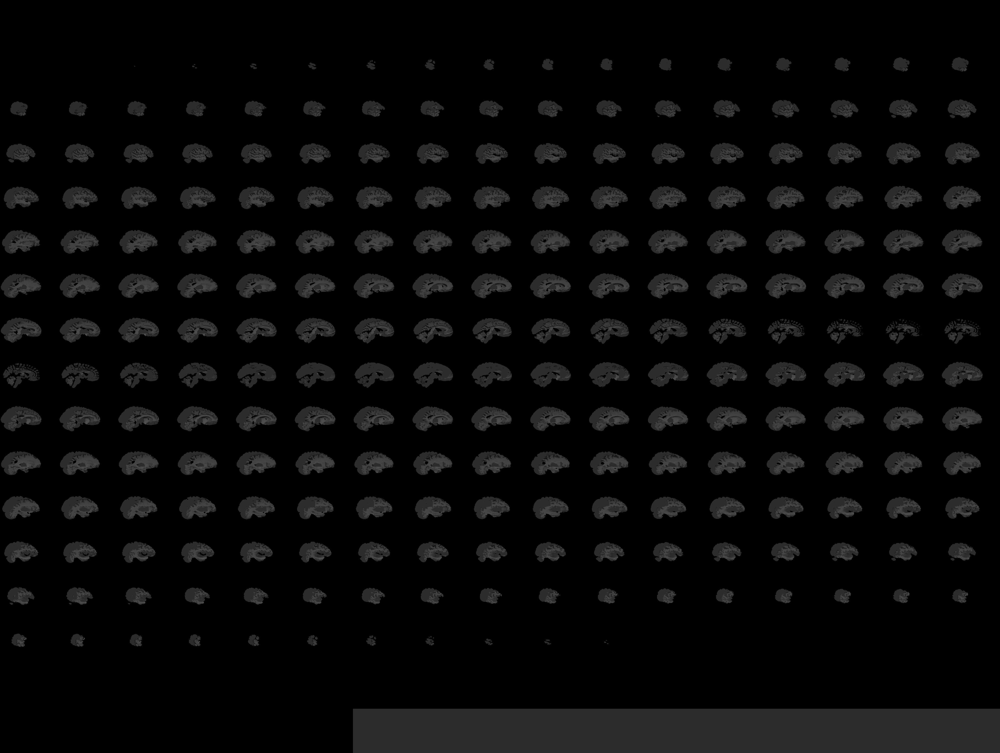
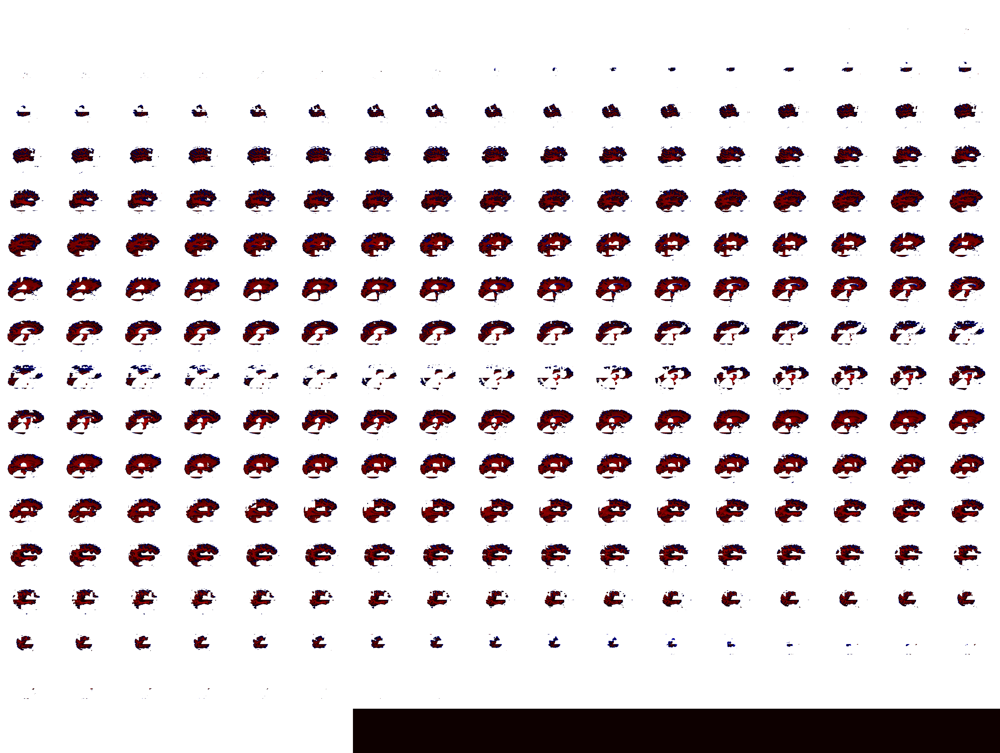

In [ ]:
img=nii.mean_img('/content/T1Img/sub-01/stripped_T1w.nii.gz')
plotting.view_img(img,bg_img=img)


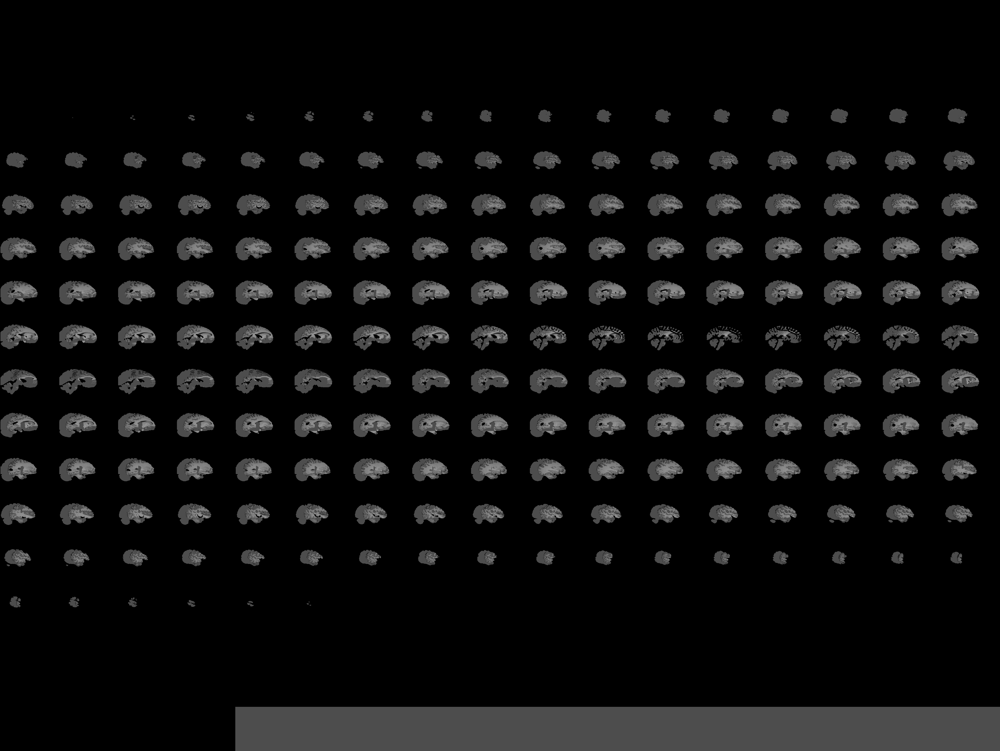
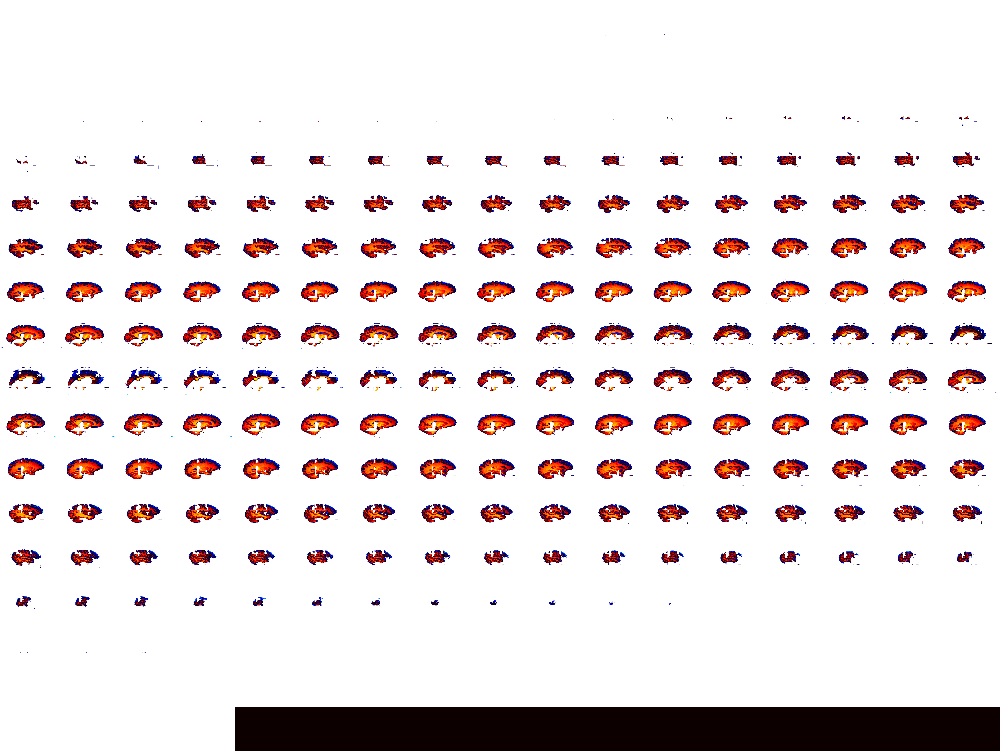

In [ ]:
img=nii.mean_img('/content/T1Img/sub-02/stripped_anat_img.nii.gz')
plotting.view_img(img,bg_img=img)


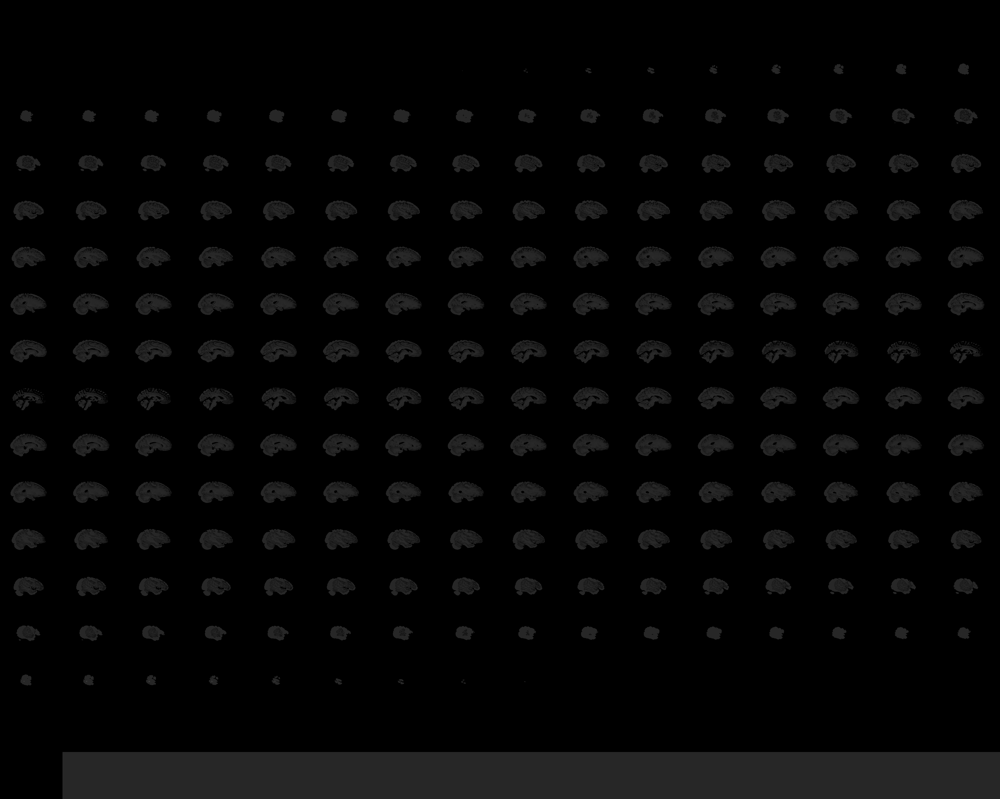
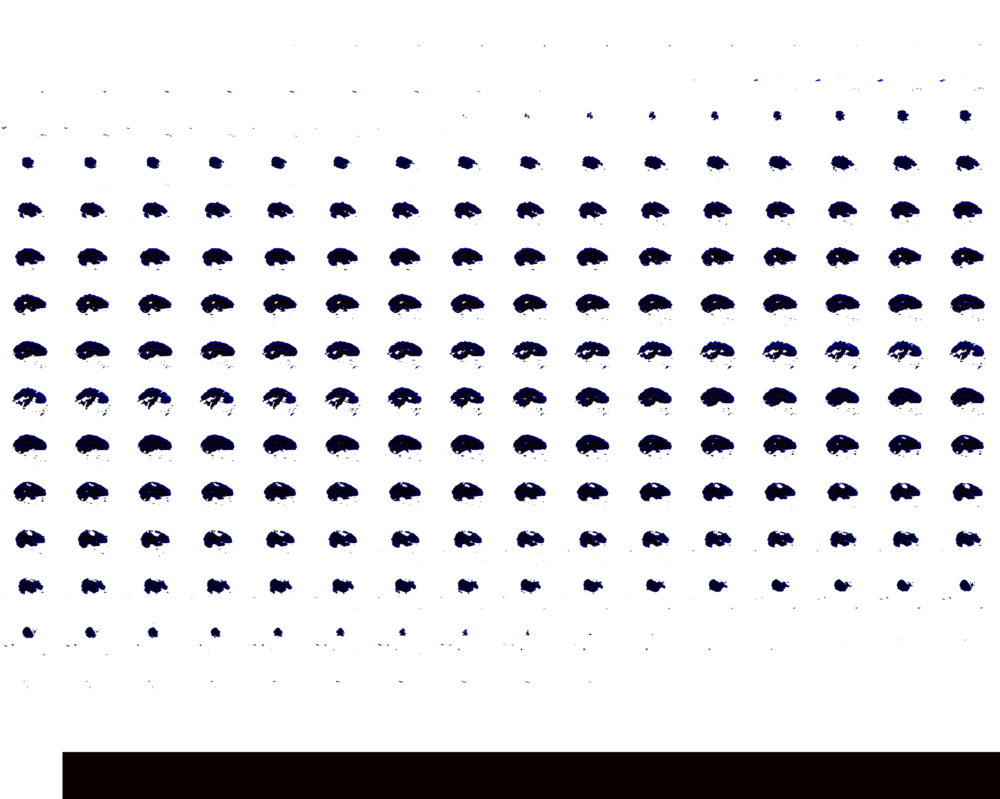

In [ ]:
img=nii.mean_img('/content/T1Img/sub-03/stripped_T1w_MRI.nii')
plotting.view_img(img,bg_img=img)


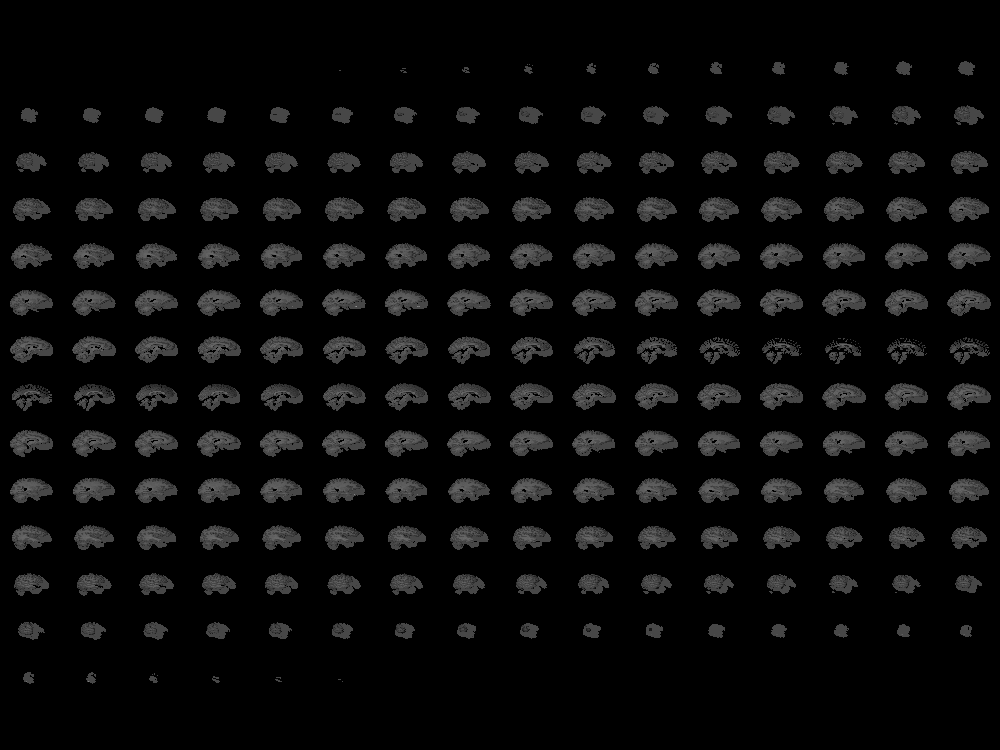
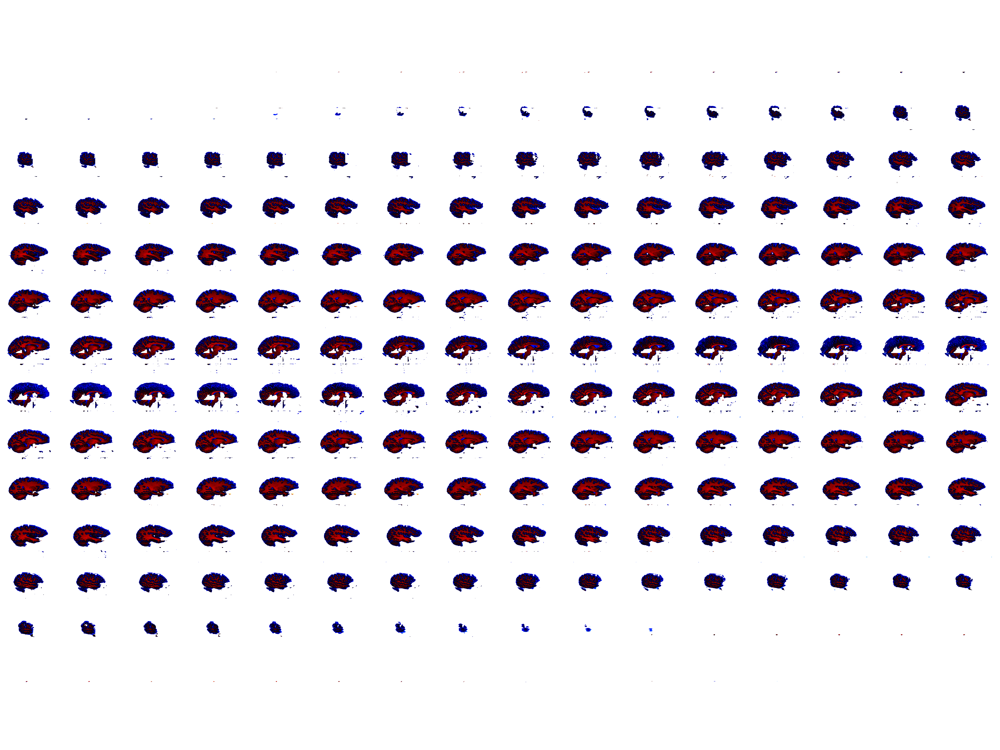

In [ ]:
img=nii.mean_img('/content/T1Img/sub-04/stripped_T1w_MRI.nii')
plotting.view_img(img,bg_img=img)


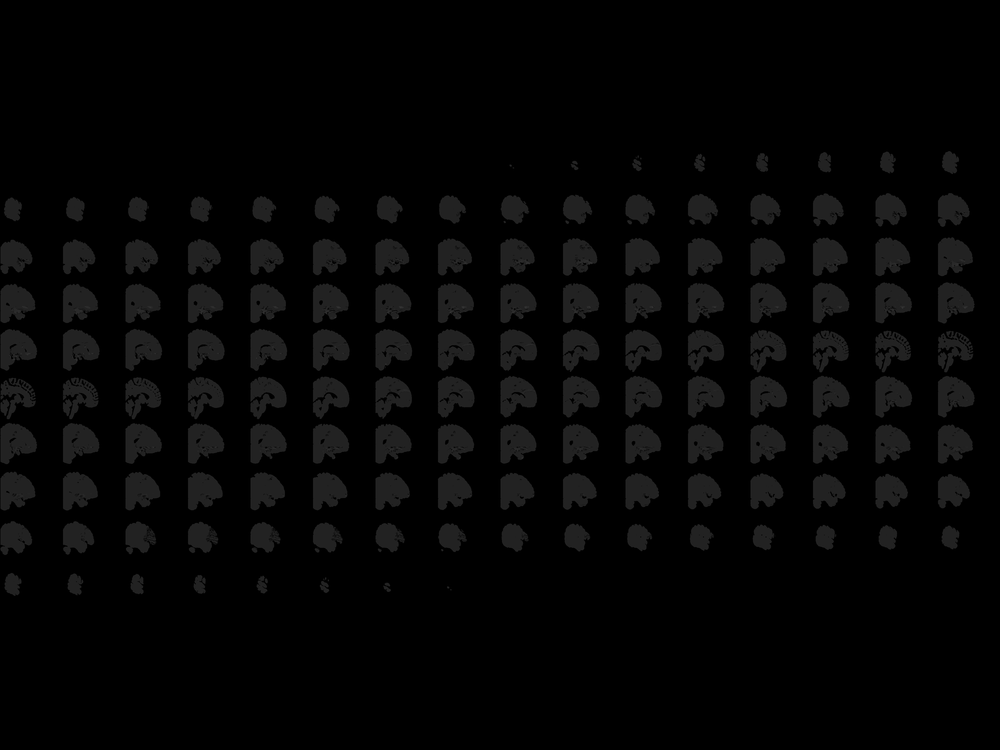
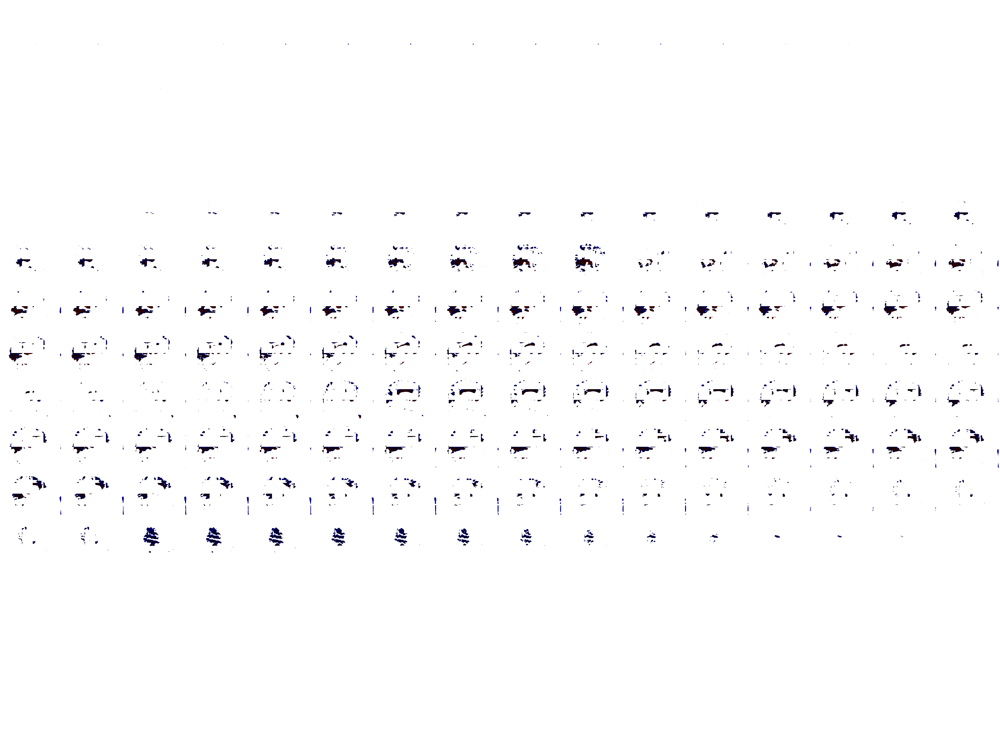

In [ ]:
img=nii.mean_img('/content/T1Img/sub-05/stripped_T1w_MRI.nii')
plotting.view_img(img,bg_img=img)

#### Shift to Lightning

In [ ]:
!pip -q install pytorch-lightning

In [ ]:
import pytorch_lightning as pl


from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks.model_checkpoint import ModelCheckpoint

In [ ]:
class DiceLoss(nn.Module):
  def __init__(self, epsilon=1e-9):
    super(DiceLoss, self).__init__()
    self.epsilon = epsilon
    self.CHANNELS_DIMENSION = 1
    self.SPATIAL_DIMENSIONS = 2, 3, 4

  def dice_score(self, output, target):
    p0 = output
    g0 = target
    p1 = 1 - p0
    g1 = 1 - g0
    tp = (p0 * g0).sum(dim=self.SPATIAL_DIMENSIONS)
    fp = (p0 * g1).sum(dim=self.SPATIAL_DIMENSIONS)
    fn = (p1 * g0).sum(dim=self.SPATIAL_DIMENSIONS)
    num = 2 * tp
    denom = 2 * tp + fp + fn + self.epsilon
    score = num / denom
    return score

  def forward(self, output, target):
    return 1 - self.dice_score(output, target)

In [ ]:
class Model(pl.LightningModule):
    def __init__(self, model, criterion, learning_rate):
        super(Model, self).__init__()
        self.model = model
        self.criterion = criterion
        self.learning_rate = learning_rate

    def forward(self, x):
        return self.model(x)

    def training_step(self, batch, batch_idx):
        x = batch['image'][tio.DATA]
        y = batch['mask'][tio.DATA]
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        loss = loss.mean()
        metrics = {"loss": loss}
        self.log_dict(metrics, on_step=True, logger=True)

        return metrics

    def validation_step(self, batch, batch_idx):
        x = batch['image'][tio.DATA]
        y = batch['mask'][tio.DATA]
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        loss = loss.mean()
        metrics = {"val_loss": loss}
        # self.log_dict(metrics, on_step=True, logger=True)

        return metrics

    def validation_epoch_end(self, outputs):
        val_loss = torch.stack([x['val_loss'] for x in outputs]).mean()
        metrics = {"val_loss": val_loss}
        self.log_dict(metrics, on_step=False, logger=True)
        return metrics
    
    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=10, 
                                                                factor=0.9, verbose=True)
        scheduler = {
            'scheduler': lr_scheduler,
            'reduce_on_plateau': True,
            'monitor': 'val_loss'
        }

        return [optimizer], [scheduler]

    def predict_step(self, batch):
        return self(batch)

## References

* http://preprocessed-connectomes-project.org/NFB_skullstripped/
* https://arxiv.org/abs/1810.10853
* https://torchio.readthedocs.io
* https://www.suyogjadhav.com/misc/2019/03/28/Using-ANTs-package-on-Google-Colaboratory/
* https://github.com/ANTsX/ANTs